In [12]:
import tensorflow as tf
from utils import bbox_utils, data_utils, drawing_utils, io_utils, train_utils, eval_utils
from models.decoder import get_decoder_model
from helper import label_generator
from models.ssd_mobilenet_v2 import get_model, init_model

In [13]:
batch_size = 8
evaluate = False
backbone = 'mobilenet_v2'
io_utils.is_valid_backbone(backbone)

hyper_params = train_utils.get_hyper_params(backbone)
test_data, size_info = data_utils.get_dataset("test", dir_ = "F:\Minor Data Collection\Final Image Data\Monument Original\TFRecord\\")
total_items = size_info

In [14]:
labels = label_generator.csv_to_label_map("helper\Report\ps-up-sp-BDS-alamy-merged.csv", 'list-type')
labels = ["bg"] + labels
hyper_params["total_labels"] = len(labels)
img_size = hyper_params["img_size"]

In [15]:
data_types = data_utils.get_data_types()
data_shapes = data_utils.get_data_shapes()
padding_values = data_utils.get_padding_values()

In [16]:
test_data = test_data.map(lambda x : data_utils.preprocessing(x, img_size, img_size))

In [6]:
# img_paths = data_utils.get_custom_imgs('./test_images')
# total_items = len(img_paths)
# test_data = tf.data.Dataset.from_generator(lambda: data_utils.custom_data_generator(
#                                            img_paths, img_size, img_size), data_types, data_shapes)

In [17]:
test_data = test_data.padded_batch(batch_size, padded_shapes=data_shapes, padding_values=padding_values)

In [18]:
ssd_model = get_model(hyper_params)
ssd_model_path = io_utils.get_model_path(backbone)
ssd_model.load_weights(ssd_model_path)

In [19]:
prior_boxes = bbox_utils.generate_prior_boxes(hyper_params["feature_map_shapes"], hyper_params["aspect_ratios"])
ssd_decoder_model = get_decoder_model(ssd_model, prior_boxes, hyper_params)

In [20]:
step_size = train_utils.get_step_size(total_items, batch_size)
pred_bboxes, pred_labels, pred_scores = ssd_decoder_model.predict(test_data, steps=step_size, verbose=1)

45/45 [==============================] - 21s 431ms/step


In [21]:
eval_utils.evaluate_predictions(test_data, pred_bboxes, pred_labels, pred_scores, labels, batch_size)

mAP: 0.8383434237216918


{1: {'label': 'badrinath temple',
  'total': 4,
  'tp': [1, 1, 1],
  'fp': [0, 0, 0],
  'scores': [0.9999757, 0.99998665, 0.9909813],
  'recall': array([0.25, 0.5 , 0.75]),
  'precision': array([1., 1., 1.]),
  'AP': 0.7272727272727273},
 2: {'label': 'basantapur tower',
  'total': 21,
  'tp': [1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1],
  'fp': [0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0],
  'scores': [0.9999908,
   0.83138406,
   0.7911802,
   0.96332014,
   0.9990274,
   0.99994195,
   0.9999995,
   0.98801374,
   0.9996062,
   0.9995721,
   0.99857295,
   0.9999945,
   0.99999964,
   0.9935359,
   0.99997973,
   0.98375535,
   0.9999926,
   0.9999993,
   0.99999976,
   0.9999771,
   0.99999845,
   0.88472426,
   0.9999403],
  'recall': array([0.04761905, 0.0952381 , 0.14285714, 0.19047619, 0.23809524,
         0.28571429, 0.33333333, 0.38095238, 0.42857143, 0.47619048,
         0.52380952, 0.57142857, 0.61904762, 0.66666667, 0.7142

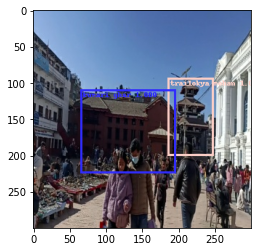

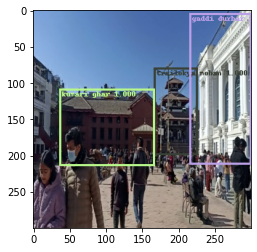

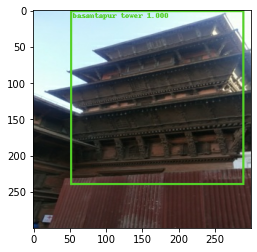

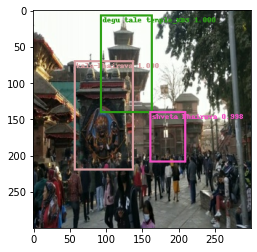

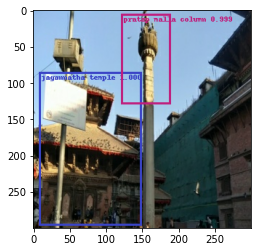

...

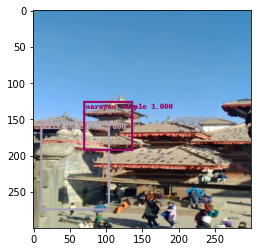

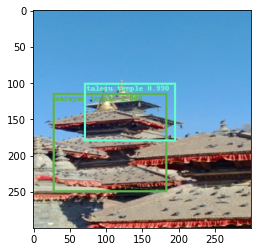

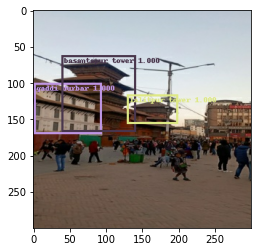

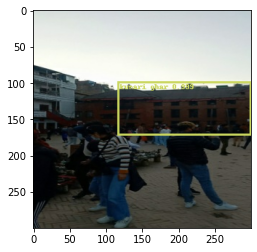

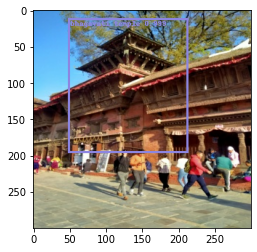

In [22]:
drawing_utils.draw_predictions(test_data, pred_bboxes, pred_labels, pred_scores, labels, batch_size)

In [23]:
from PIL import Image
img = Image.open('test_images\IMG20230122143048.jpg')
height, width = img.size
y1 = pred_bboxes[..., 0] * height
x1 = pred_bboxes[..., 1] * width
y2 = pred_bboxes[..., 2] * height
x2 = pred_bboxes[..., 3] * width
y1 = int(y1[0][0])
x1 = int(x1[0][0])
y2 = int(y2[0][0])
x2 = int(x2[0][0])


In [24]:
label = labels[int(pred_labels[0][0])]
predicted_score = "%.4f" % pred_scores[0][0]
label = label + " " + str(float(predicted_score) * 100) + " %"

In [25]:
import cv2
img = cv2.imread('test_images\IMG20230122143048.jpg')
cv2.rectangle(img, (x1, y1 + 10), (x2, y2), color = (0, 0, 255), thickness = 15)
cv2.putText(img, label, (x1, y1), cv2.FONT_HERSHEY_SIMPLEX, 4, (0, 0, 0), 15, cv2.LINE_AA)
# cv2.imwrite("bounding.jpg", img)

array([[[250, 255, 252],
        [248, 255, 250],
        [249, 255, 251],
        ...,
        [102, 108, 103],
        [105, 110, 108],
        [103, 108, 106]],

       [[250, 255, 252],
        [248, 255, 250],
        [249, 255, 251],
        ...,
        [102, 108, 103],
        [107, 110, 108],
        [105, 108, 106]],

       [[250, 255, 252],
        [248, 255, 250],
        [248, 255, 250],
        ...,
        [103, 107, 102],
        [108, 106, 105],
        [109, 105, 104]],

       ...,

       [[ 30,  68,  46],
        [ 37,  64,  44],
        [ 56,  61,  46],
        ...,
        [ 34,  24,  17],
        [ 29,  23,  18],
        [ 24,  21,  16]],

       [[  9, 144,  76],
        [ 31, 133,  75],
        [ 33,  66,  32],
        ...,
        [ 38,  23,  20],
        [ 34,  23,  19],
        [ 28,  19,  15]],

       [[  0, 158,  66],
        [  7, 147,  70],
        [ 24,  70,  27],
        ...,
        [ 45,  30,  28],
        [ 40,  25,  22],
        [ 30,  18,  14]]

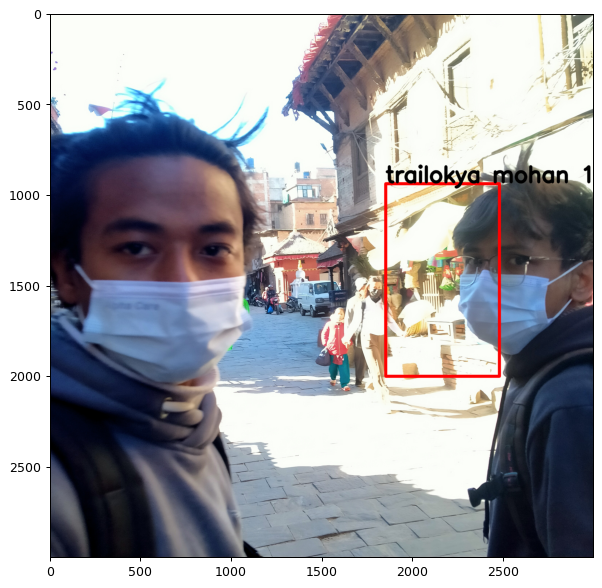

In [26]:
import matplotlib.pyplot as plt
plt.figure(figsize = (10, 8), dpi = 90)
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
# plt.axis('off')
plt.show()